In [ ]:
!pip install pandas
!pip install matplotlib
!pip install scikit-learn
!pip install geopy
!pip install folium

# Correlation Matrix (Company, Industry, Country)

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
from geopy.geocoders import Nominatim

file_path = 'catA_train.csv'  # replace with your file path
df = pd.read_csv(file_path)

geolocator = Nominatim(user_agent="testUser")

# Convert categorical variables to numeric for correlation calculation
label_encoder = LabelEncoder()
df['Company'] = label_encoder.fit_transform(df['Company'])
df['Industry'] = label_encoder.fit_transform(df['Industry'])
df['Country'] = label_encoder.fit_transform(df['Global Ultimate Country'])

# fetching the country based on latitude and longitude
# df['Country'] = None
# for index, row in df.iterrows():
#     latitude = row['LATITUDE']  # Assuming you have latitude and longitude columns
#     longitude = row['LONGITUDE']

#     # Reverse geocode the coordinates
#     location = geolocator.reverse(f"{latitude}, {longitude}")

#     if location:
#         country = location.raw['address']['country']
#         df.loc[index, 'Country'] = country

# Calculate correlation matrix
corr = df[['Company', 'Industry', 'Country', 'Sales (Global Ultimate Total USD)']].corr()

# Display the correlation matrix
print(corr)

# Visualize the correlation matrix using a heatmap
plt.matshow(corr)
plt.colorbar()
plt.show()

ModuleNotFoundError: No module named 'sklearn'

# Correlation b/w Employee and Sales (Domestic, Global)

In [ ]:
import pandas as pd
import numpy as np

file_path = 'catA_train.csv'  # replace with your file path
df = pd.read_csv(file_path)

employee_sales_correlation = df["Employees (Global Ultimate Total)"].corr(df["Sales (Global Ultimate Total USD)"])
employee_sales_correlation_domestic = df["Employees (Domestic Ultimate Total)"].corr(df["Sales (Domestic Ultimate Total USD)"])

N = df.shape[0]

# Calculate threshold for significance at 5% level
threshold = 2 / np.sqrt(N)

employee_sales_correlation_percentage = abs(employee_sales_correlation) * 100
employee_sales_correlation_domestic_percentage = abs(employee_sales_correlation_domestic) * 100

print(f"Correlation between Employees and Sales (Global Ultimate): {employee_sales_correlation:.10f} ({employee_sales_correlation_percentage:.2f}%)")
print(f"Correlation between Employees and Sales (Domestic Ultimate): {employee_sales_correlation_domestic:.10f} ({employee_sales_correlation_domestic_percentage:.2f}%)")
print(f"The threshold for significance at the 5% level is: {threshold:.10f}")


# Check for significance
print("Employee-Sales correlation (Global Ultimate) is likely significant at 5% level:" if abs(employee_sales_correlation) > threshold else "Employee-Sales correlation (Global Ultimate) may not be significant at 5% level.")
print("Employee-Sales correlation (Domestic Ultimate) is likely significant at 5% level:" if abs(employee_sales_correlation_domestic) > threshold else "Employee-Sales correlation (Domestic Ultimate) may not be significant at 5% level.")

Correlation between Employees and Sales (Global Ultimate): 0.6634780577 (66.35%)
Correlation between Employees and Sales (Domestic Ultimate): 0.0169066099 (1.69%)
The threshold for significance at the 5% level is: 0.0117077238
Employee-Sales correlation (Global Ultimate) is likely significant at 5% level:
Employee-Sales correlation (Domestic Ultimate) is likely significant at 5% level:


# KNN 

# KNN With latitude and year (Doesnt matter tho, since all companies are in the Singapore)

In [ ]:
import pandas as pd
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error 

file_path = 'catA_train.csv'  
data = pd.read_csv(file_path)

data = data.dropna(subset=["LATITUDE", "LONGITUDE", "Year Found"])


features = data[["LATITUDE", "Year Found"]] 
target = data["Sales (Domestic Ultimate Total USD)"] 


X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.3, random_state=42)


knn = KNeighborsRegressor(n_neighbors=5000)


knn.fit(X_train, y_train)

predictions = knn.predict(X_test)


mse = mean_squared_error(y_test, predictions)
print("Mean Squared Error:", mse)


Mean Squared Error: 1.0038499182401762e+20


In [ ]:
!pip install seaborn
!pip install folium

# HeatMap by Global Sales in countries

<ipython-input-70-1ee6257ade97>:8: FutureWarning: In a future version of pandas all arguments of DataFrame.pivot will be keyword-only.
  pivot_table = sales_data.pivot('Parent Country', 'Global Ultimate Country', 'Sales (Global Ultimate Total USD)')


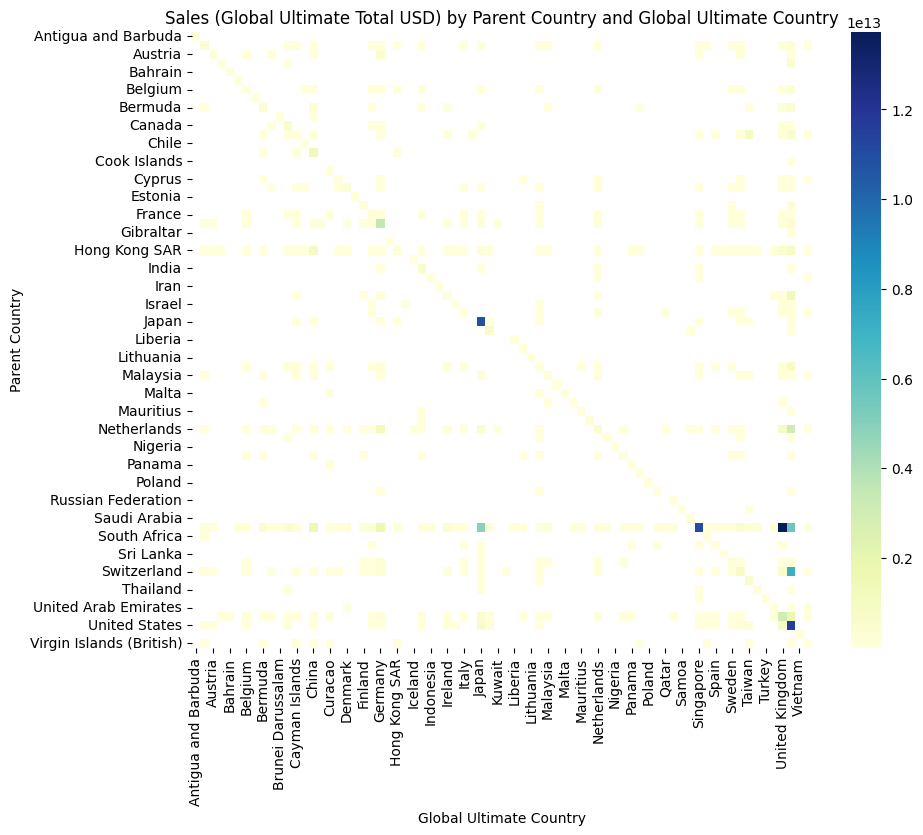

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Aggregate sales data
sales_data = df.groupby(['Parent Country', 'Global Ultimate Country'])['Sales (Global Ultimate Total USD)'].sum().reset_index()

# Create a pivot table for the heatmap
pivot_table = sales_data.pivot('Parent Country', 'Global Ultimate Country', 'Sales (Global Ultimate Total USD)')

# Create a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(pivot_table, cmap='YlGnBu')

plt.title('Sales (Global Ultimate Total USD) by Parent Country and Global Ultimate Country')
plt.xlabel('Global Ultimate Country')
plt.ylabel('Parent Country')
plt.show()

# WorldMap with Global Sales (Most refined version and the bottom of this file)

In [ ]:
import folium
from folium.plugins import HeatMap

df = df.dropna(subset=['LATITUDE', 'LONGITUDE', 'Sales (Global Ultimate Total USD)'])

m = folium.Map(location=[0, 0], zoom_start=2)

heat_data = [[row['LATITUDE'], row['LONGITUDE'], row['Sales (Global Ultimate Total USD)']] for index, row in df.iterrows()]
HeatMap(heat_data, radius=20).add_to(m)

m

# HeatMap with pure coordinates and Total Sales calculated

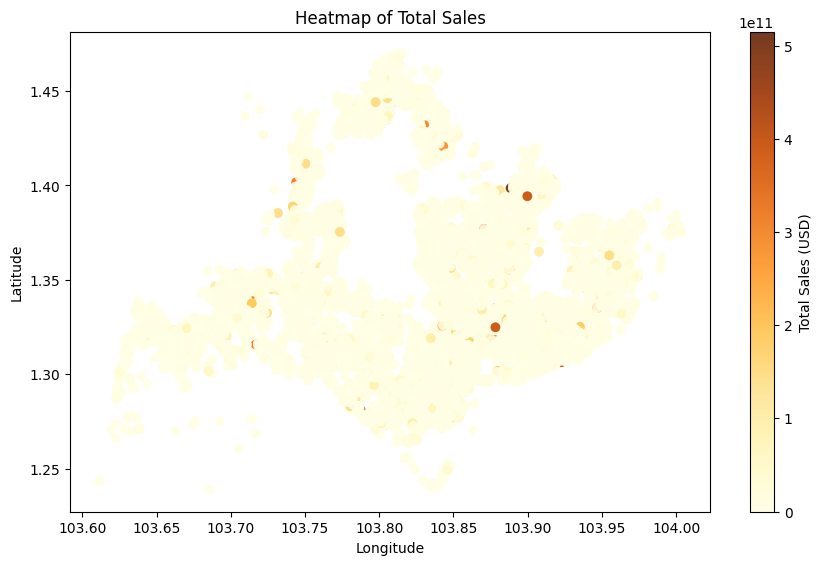

In [85]:

file_path = 'catA_train.csv' 
df = pd.read_csv(file_path)

df = df.dropna(subset=['LATITUDE', 'LONGITUDE', 'Sales (Global Ultimate Total USD)', 'Sales (Domestic Ultimate Total USD)'])

df["Total Sales"] = df["Sales (Domestic Ultimate Total USD)"] + df["Sales (Global Ultimate Total USD)"]

import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.scatter(df["LONGITUDE"], df["LATITUDE"], c=df["Total Sales"], cmap="YlOrBr", s=50, alpha=0.9)

plt.set_cmap('YlOrBr')
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)

plt.colorbar(label="Total Sales (USD)")

plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title("Heatmap of Total Sales")

plt.show()

# Heat Map with Global Sales based on lcoation (Cleaner version). all companies are in the Singapore

In [82]:
import pandas as pd
import folium

file_path = './catA_train.csv'
df = pd.read_csv(file_path)

# df = df.head(5000)

data = df.dropna(subset=['LATITUDE', 'LONGITUDE',
                 'Sales (Global Ultimate Total USD)', 'Sales (Domestic Ultimate Total USD)']).copy()

# Calculate the weight of each point
# data['weight'] = data['Sales (Global Ultimate Total USD)'] + \
#     data['Sales (Domestic Ultimate Total USD)']

m = folium.Map(zoom_start=2)

for idx, row in data.iterrows():
    folium.CircleMarker(
        location=[row['LATITUDE'], row['LONGITUDE']],
        radius=row['Sales (Domestic Ultimate Total USD)'] / 10000000000,
        color='blue',
        fill=True,
        fill_color='blue'
    ).add_to(m)

m


# Top 5 growing industries

In [87]:
import pandas as pd

file_path = './catA_train.csv'
df = pd.read_csv(file_path)

df["Growth Rate"] = df.groupby("Industry")["Sales (Domestic Ultimate Total USD)"].pct_change()

avg_growth_rate = df.groupby("Industry")["Growth Rate"].mean()

median_growth_rate = df.groupby("Industry")["Growth Rate"].median()

std_dev_growth_rate = df.groupby("Industry")["Growth Rate"].std()

growth_metrics = pd.DataFrame({
    "Average Growth Rate": avg_growth_rate,
    "Median Growth Rate": median_growth_rate,
    "Standard Deviation": std_dev_growth_rate
})

growth_metrics = growth_metrics.sort_values(by="Average Growth Rate", ascending=False)

print("Top 5 Industries with Highest Average Growth Rate:")
print(growth_metrics.head(5).to_string())


Top 5 Industries with Highest Average Growth Rate:
                                                         Average Growth Rate  Median Growth Rate  Standard Deviation
Industry                                                                                                            
Dairy Products, Except Dried or Canned                          75631.852645            0.634850        2.828830e+05
Cordage and Twine                                               62390.312417           -0.807955        1.247824e+05
Management Consulting Services                                  36347.361175            0.000000        1.340899e+06
Chemicals and Allied Products, Not Elsewhere Classified         33671.563354           -0.034461        5.279192e+05
Offices of Holding Companies, Not Elsewhere Classified          20596.494793            0.000000        1.715140e+06
